# 1 Objectif


Ce notebook est une exploration des données Demandes de Valeurs Foncières

# 2 Imports

In [1]:
import pandas as pd
import geopandas as gpd
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
import psycopg2 as psql
import sqlalchemy
import plotly.graph_objects as go
import numpy as np
import plotly.express as px
import seaborn as sbn
from keplergl import KeplerGl
import fiona
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

plt.rcParams["figure.figsize"] = (15, 12) # (w, h)

# 3 Analyse

## 3.1 Lecture des données et vérifications

### 3.1.1 Données tabulaires

In [2]:
from sqlalchemy import create_engine
# Postgres username, password, and database name
POSTGRES_ADDRESS = 'localhost' ## INSERT YOUR DB ADDRESS IF IT'S NOT ON PANOPLY
POSTGRES_PORT = '5432'
POSTGRES_USERNAME = 'postgres' ## CHANGE THIS TO YOUR PANOPLY/POSTGRES USERNAME
POSTGRES_PASSWORD = 'oleroN17310' ## CHANGE THIS TO YOUR PANOPLY/POSTGRES PASSWORD 
POSTGRES_DBNAME = 'dvf' ## CHANGE THIS TO YOUR DATABASE NAME
# A long string that contains the necessary Postgres login information
postgres_str = ('postgresql://{username}:{password}@{ipaddress}:{port}/{dbname}'
                .format(username=POSTGRES_USERNAME,
                        password=POSTGRES_PASSWORD,
                        ipaddress=POSTGRES_ADDRESS,
                        port=POSTGRES_PORT,
                        dbname=POSTGRES_DBNAME))
# Create the connection
cnx = create_engine(postgres_str)

In [3]:
# Crée un DataFrame comprenant les DVF+ sur les communes du Pays Marennes Oléron
df = pd.read_sql_query('''SELECT * FROM dvf_d17.mutation WHERE l_codinsee IN ('{17265}', '{17351}', '{17140}', '{17406}', '{17219}', '{17185}', '{17385}', '{17411}', '{17093}', '{17058}', '{17323}', '{17337}', '{17485}', '{17486}')''', cnx)

In [4]:
# Histoire de voir à quoi le bitin ressemble, avec toutes ses colonnes
pd.set_option('max_columns',None)
df.head()

,idmutation,idmutinvar,idopendata,idnatmut,codservch,refdoc,datemut,anneemut,moismut,coddep,libnatmut,nbartcgi,l_artcgi,vefa,valeurfonc,nbdispo,nblot,nbcomm,l_codinsee,nbsection,l_section,nbpar,l_idpar,nbparmut,l_idparmut,nbsuf,sterr,l_dcnt,nbvolmut,nblocmut,l_idlocmut,nblocmai,nblocapt,nblocdep,nblocact,nbapt1pp,nbapt2pp,nbapt3pp,nbapt4pp,nbapt5pp,nbmai1pp,nbmai2pp,nbmai3pp,nbmai4pp,nbmai5pp,sbati,sbatmai,sbatapt,sbatact,sapt1pp,sapt2pp,sapt3pp,sapt4pp,sapt5pp,smai1pp,smai2pp,smai3pp,smai4pp,smai5pp,geomlocmut,geomparmut,geompar,codtypbien,libtypbien
0,1129023,a14349a6c4a57e352cf9eaa965caf5cd,a14349a6c4a57e352cf9eaa965caf5cd,1,None,None,2015-06-24,2015,6,17,Vente,0,None,False,629200.00,2,0,1,[17385],1,[AK],3,"[17385000AK0862, 17385000AK0864, 17385000AK0866]",3,"[17385000AK0862, 17385000AK0864, 17385000AK0866]",3,3146.0,"[0, 0, 0, 0, 0, 0, 0, 0, 3146, 0, 0, 0, 0]",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,None,None,None,221,TERRAIN D'AGREMENT
1,1133891,e8463e4ea1bf3da2a65fc535bad198de,e8463e4ea1bf3da2a65fc535bad198de,1,None,None,2015-03-31,2015,3,17,Vente,0,None,False,120000.00,1,0,1,[17219],1,[0O],29,"[172190000O0046, 172190000O0048, 172190000O004...",29,"[172190000O0046, 172190000O0048, 172190000O004...",32,60147.0,"[0, 4397, 0, 0, 0, 36668, 0, 18510, 0, 0, 0, 0...",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,None,01060000206A080000040000000103000000010000000D...,01060000206A080000040000000103000000010000000D...,20,TERRAIN NON BATIS INDETERMINE
2,945900,523ef046bad88f1cc05ff718496455a2,523ef046bad88f1cc05ff718496455a2,1,None,None,2019-07-15,2019,7,17,Vente,0,None,False,1800.00,1,0,1,[17058],1,[AN],1,[17058000AN0742],1,[17058000AN0742],1,24.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 24]",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,None,None,None,229,TERRAIN ARTIFICIALISE MIXTE
3,999286,cdefb371f4c014847d8d97cf64e8e5aa,cdefb371f4c014847d8d97cf64e8e5aa,1,None,None,2018-02-27,2018,2,17,Vente,0,None,False,18.48,1,0,1,[17323],1,[0B],1,[173230000B2488],1,[173230000B2488],1,42.0,"[0, 0, 0, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0]",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,None,01060000206A0800000100000001030000000100000005...,01060000206A0800000100000001030000000100000005...,233,TERRAIN LANDES ET EAUX
4,1129318,a5c8639342ffe98a103060c57b6ea5fe,a5c8639342ffe98a103060c57b6ea5fe,1,None,None,2015-09-22,2015,9,17,Vente,0,None,False,67000.00,1,2,1,[17337],1,[AS],1,[17337000AS0136],0,None,0,0.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0,2,"[173370001400180_0, 173370001400181_0]",1,0,1,0,0,0,0,0,0,1,0,0,0,0,19.0,19.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,19.0,0.0,0.0,0.0,0.0,01010000206A080000EF47C891E84F1641D47A3AD1AFFF...,None,01060000206A0800000100000001030000000100000005...,111,UNE MAISON


In [5]:
# Renvoie le nom des colonnes, ainsi que leur type et le compte des non-null (et permet donc de savoir si des champs sont null)
df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8820 entries, 0 to 8819
Data columns (total 64 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   idmutation  8820 non-null   int64  
 1   idmutinvar  8820 non-null   object 
 2   idopendata  8820 non-null   object 
 3   idnatmut    8820 non-null   int64  
 4   codservch   0 non-null      object 
 5   refdoc      0 non-null      object 
 6   datemut     8820 non-null   object 
 7   anneemut    8820 non-null   int64  
 8   moismut     8820 non-null   int64  
 9   coddep      8820 non-null   object 
 10  libnatmut   8820 non-null   object 
 11  nbartcgi    8820 non-null   int64  
 12  l_artcgi    0 non-null      object 
 13  vefa        8820 non-null   bool   
 14  valeurfonc  8805 non-null   float64
 15  nbdispo     8820 non-null   int64  
 16  nblot       8820 non-null   int64  
 17  nbcomm      8820 non-null   int64  
 18  l_codinsee  8820 non-null   object 
 19  nbsection   8820 non-null  

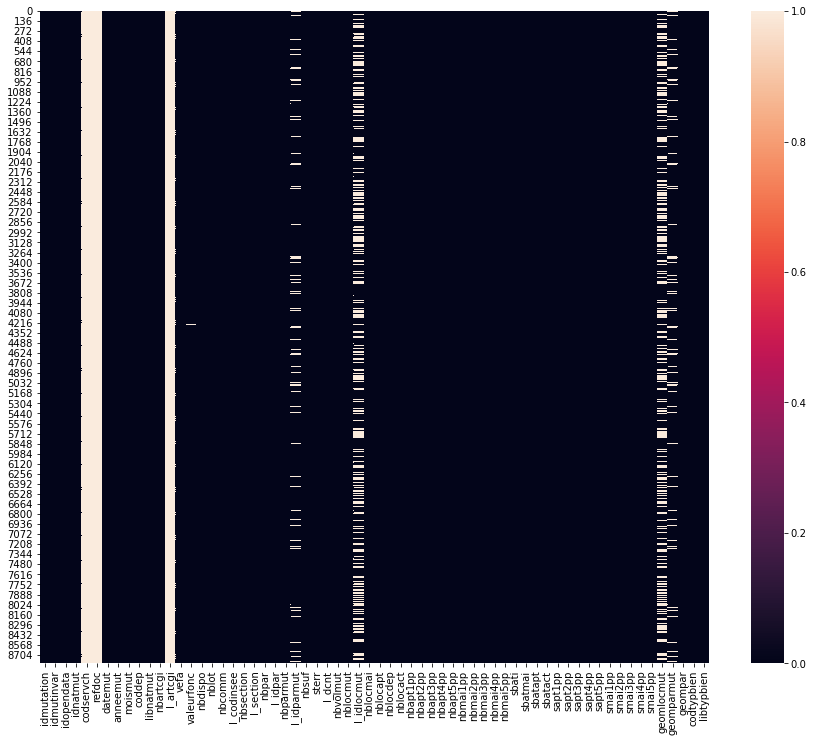

In [7]:
# Permet d'avoir une idée visuelle, de l'ampleur des null par colonne
sbn.heatmap(df.isnull())

Apparemment, les valeurfonc ont quelques null, qui ne nous intéressent donc pas.  
On vérifie également les valeurs de surface de terrain nulles, voire faible

In [6]:
df = df.loc[df['sterr'] != 0]
df = df.loc[df['valeurfonc'] != 0]

In [7]:
df.head()

,idmutation,idmutinvar,idopendata,idnatmut,codservch,refdoc,datemut,anneemut,moismut,coddep,libnatmut,nbartcgi,l_artcgi,vefa,valeurfonc,nbdispo,nblot,nbcomm,l_codinsee,nbsection,l_section,nbpar,l_idpar,nbparmut,l_idparmut,nbsuf,sterr,l_dcnt,nbvolmut,nblocmut,l_idlocmut,nblocmai,nblocapt,nblocdep,nblocact,nbapt1pp,nbapt2pp,nbapt3pp,nbapt4pp,nbapt5pp,nbmai1pp,nbmai2pp,nbmai3pp,nbmai4pp,nbmai5pp,sbati,sbatmai,sbatapt,sbatact,sapt1pp,sapt2pp,sapt3pp,sapt4pp,sapt5pp,smai1pp,smai2pp,smai3pp,smai4pp,smai5pp,geomlocmut,geomparmut,geompar,codtypbien,libtypbien
0,1129023,a14349a6c4a57e352cf9eaa965caf5cd,a14349a6c4a57e352cf9eaa965caf5cd,1,None,None,2015-06-24,2015,6,17,Vente,0,None,False,629200.00,2,0,1,[17385],1,[AK],3,"[17385000AK0862, 17385000AK0864, 17385000AK0866]",3,"[17385000AK0862, 17385000AK0864, 17385000AK0866]",3,3146.0,"[0, 0, 0, 0, 0, 0, 0, 0, 3146, 0, 0, 0, 0]",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,None,None,None,221,TERRAIN D'AGREMENT
1,1133891,e8463e4ea1bf3da2a65fc535bad198de,e8463e4ea1bf3da2a65fc535bad198de,1,None,None,2015-03-31,2015,3,17,Vente,0,None,False,120000.00,1,0,1,[17219],1,[0O],29,"[172190000O0046, 172190000O0048, 172190000O004...",29,"[172190000O0046, 172190000O0048, 172190000O004...",32,60147.0,"[0, 4397, 0, 0, 0, 36668, 0, 18510, 0, 0, 0, 0...",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,None,01060000206A080000040000000103000000010000000D...,01060000206A080000040000000103000000010000000D...,20,TERRAIN NON BATIS INDETERMINE
2,945900,523ef046bad88f1cc05ff718496455a2,523ef046bad88f1cc05ff718496455a2,1,None,None,2019-07-15,2019,7,17,Vente,0,None,False,1800.00,1,0,1,[17058],1,[AN],1,[17058000AN0742],1,[17058000AN0742],1,24.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 24]",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,None,None,None,229,TERRAIN ARTIFICIALISE MIXTE
3,999286,cdefb371f4c014847d8d97cf64e8e5aa,cdefb371f4c014847d8d97cf64e8e5aa,1,None,None,2018-02-27,2018,2,17,Vente,0,None,False,18.48,1,0,1,[17323],1,[0B],1,[173230000B2488],1,[173230000B2488],1,42.0,"[0, 0, 0, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0]",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,None,01060000206A0800000100000001030000000100000005...,01060000206A0800000100000001030000000100000005...,233,TERRAIN LANDES ET EAUX
5,1158791,2636881938ec11315d969f77c7aff80d,2636881938ec11315d969f77c7aff80d,1,None,None,2014-02-26,2014,2,17,Vente,0,None,False,74250.00,1,0,1,[17385],1,[CN],1,[17385000CN1111],1,[17385000CN1111],1,297.0,"[297, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,None,None,None,2313,TERRAIN DE TYPE TERRE ET PRE


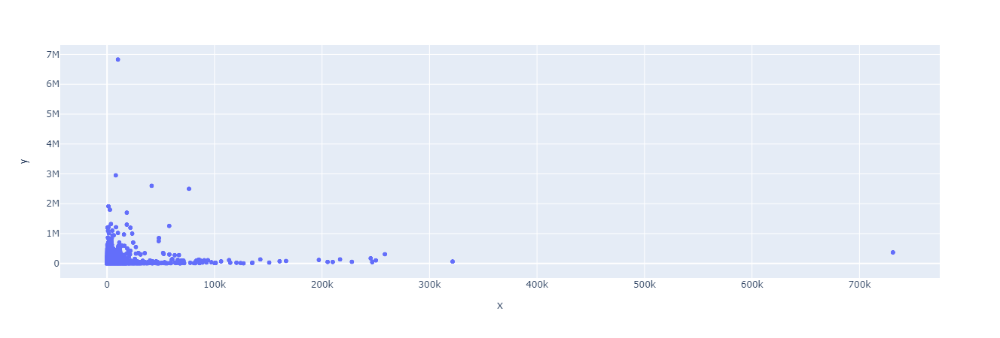

In [27]:
fig = px.scatter(x=df['sterr'], y=df['valeurfonc'])
fig.show()

In [9]:
df['prix_m2'] = df['valeurfonc']/df['sterr']

In [26]:
df['prix_m2'].describe()

count     8000.000000
mean       373.487211
std        647.976378
min          0.000020
25%         63.217694
50%        218.034184
75%        458.878598
max      35000.000000
Name: prix_m2, dtype: float64

Il doit y avoir des valeurs sterr très faibles, qui ne nous intéressent pas.  

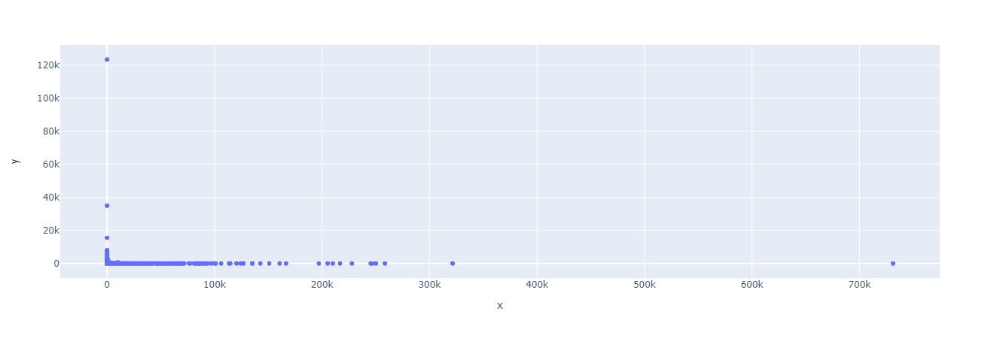

In [10]:
fig = px.scatter(x=df['sterr'], y=df['prix_m2'])
fig.show()

In [11]:
df = df.loc[df['sterr'] > 20]

In [12]:
df['prix_m2'] = df['valeurfonc']/df['sterr']

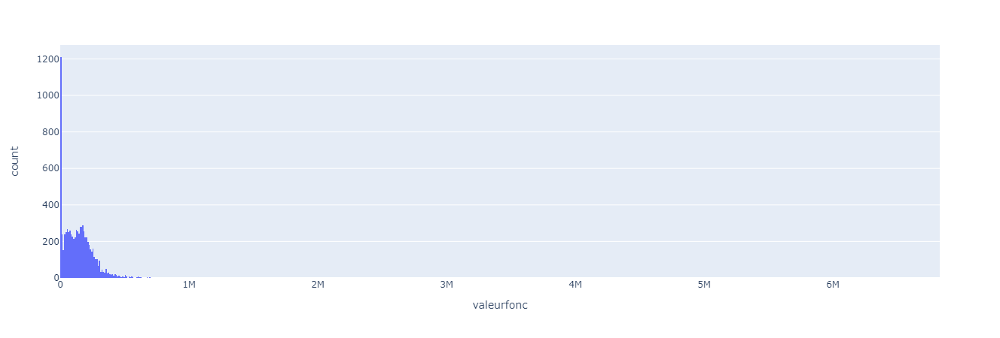

In [13]:
fig = px.histogram(df, x="valeurfonc")
fig.show()

Même en enlevant les sterr<20m², il reste une sur-représentation des mutations<10 000 €

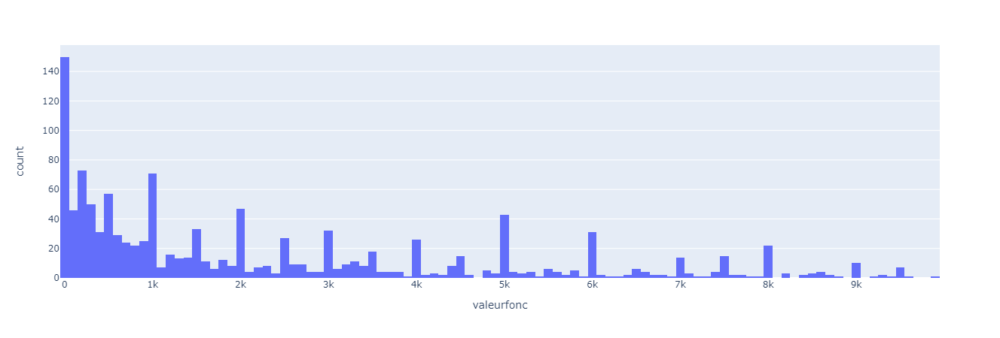

In [14]:
# Filtre sur les valeurs de valeurfonc < 10 000€
df_vf_10000 = df[df["valeurfonc"] < 10000]

fig = px.histogram(df_vf_10000, x="valeurfonc", nbins=100)
fig.show()

Apparemment il y aurait des terrains vendus à des prix très bas...

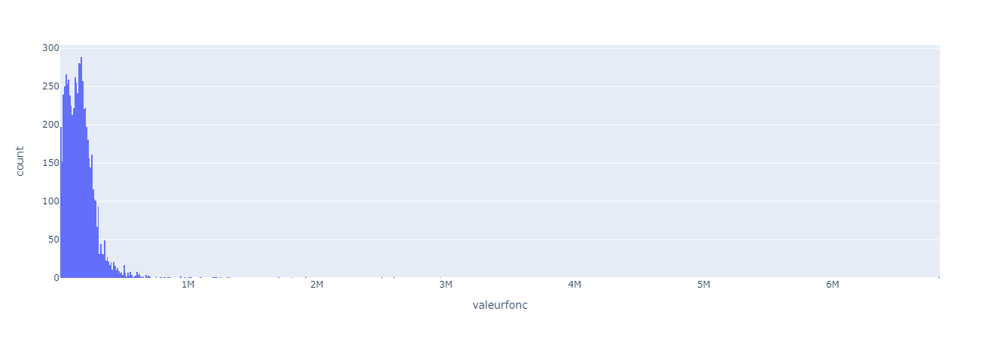

In [15]:
df_vf_10000 = df[df["valeurfonc"] > 10000]

fig = px.histogram(df_vf_10000, x="valeurfonc")
fig.show()

On va sans doute également sortir le bien apparemment exceptionnel vendu à plus de 6 millions d'euros...

In [24]:
df['valeurfonc'].describe()

count    7.903000e+03
mean     1.406131e+05
std      1.549654e+05
min      1.500000e-01
25%      4.500000e+04
50%      1.255000e+05
75%      2.000000e+05
max      6.828855e+06
Name: valeurfonc, dtype: float64

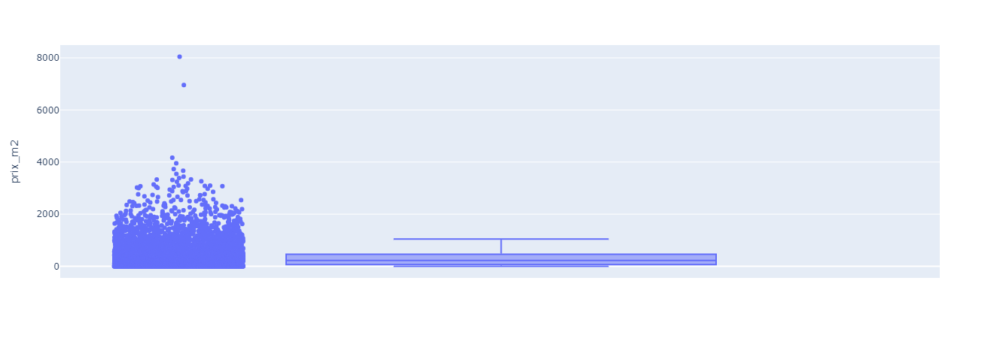

In [42]:
fig = px.box(df, y="prix_m2", points="all",
            hover_data={'idmutation':True,
                       'valeurfonc':True,
                       'sterr':True})
fig.show()

In [41]:
df.loc[df['idmutation'] == 1089985]

,idmutation,idmutinvar,idopendata,idnatmut,codservch,refdoc,datemut,anneemut,moismut,coddep,libnatmut,nbartcgi,l_artcgi,vefa,valeurfonc,nbdispo,nblot,nbcomm,l_codinsee,nbsection,l_section,nbpar,l_idpar,nbparmut,l_idparmut,nbsuf,sterr,l_dcnt,nbvolmut,nblocmut,l_idlocmut,nblocmai,nblocapt,nblocdep,nblocact,nbapt1pp,nbapt2pp,nbapt3pp,nbapt4pp,nbapt5pp,nbmai1pp,nbmai2pp,nbmai3pp,nbmai4pp,nbmai5pp,sbati,sbatmai,sbatapt,sbatact,sapt1pp,sapt2pp,sapt3pp,sapt4pp,sapt5pp,smai1pp,smai2pp,smai3pp,smai4pp,smai5pp,geomlocmut,geomparmut,geompar,codtypbien,libtypbien,prix_m2
5754,1089985,b193266eb4d4ffb94917bf21f57808d1,b193266eb4d4ffb94917bf21f57808d1,1,None,None,2016-01-25,2016,1,17,Vente,0,None,False,185000.0,1,2,1,[17411],1,[0C],1,[174110000C1946],1,[174110000C1946],1,23.0,"[0, 0, 0, 0, 0, 0, 0, 0, 23, 0, 0, 0, 0]",0,1,[174110001350911_0],1,0,0,0,0,0,0,0,0,0,0,1,0,0,47.0,47.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.0,0.0,0.0,01010000206A0800006AD1BF859AC11641D47DB684EFEB...,01060000206A080000010000000103000000010000000B...,01060000206A080000010000000103000000010000000B...,111,UNE MAISON,8043.478261


In [47]:
df = df.loc[df['sterr'] > 30]

In [48]:
df['prix_m2'] = df['valeurfonc']/df['sterr']

In [49]:
df['prix_m2'].describe()

count    7818.000000
mean      360.509932
std       450.207651
min         0.000020
25%        67.073750
50%       220.253601
75%       457.913841
max      3730.555556
Name: prix_m2, dtype: float64

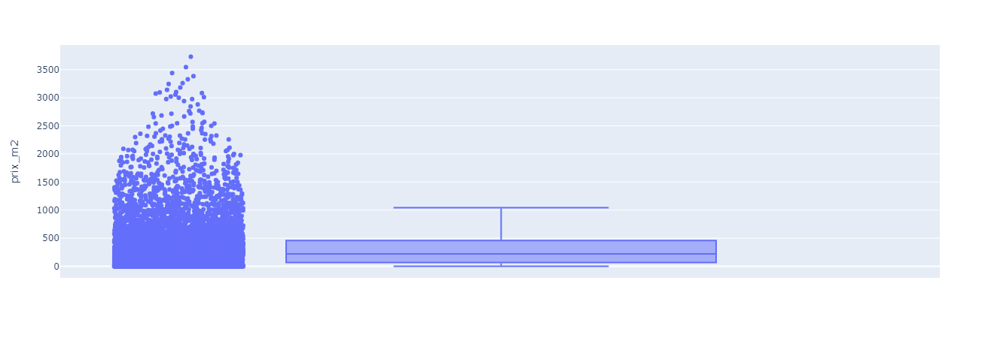

In [50]:
fig = px.box(df, y="prix_m2", points="all",
            hover_data={'idmutation':True,
                       'valeurfonc':True,
                       'sterr':True})
fig.show()

Il y a quand même pas mal de cas un peu bizarres...  
Un terrain de 36m² vendu 134300€...

### 3.1.2 Données géolocalisées

#### 3.1.2.1 Connection Postgis

# Définit les paramètres de connexion à PostGis
con = psql.connect(database="dvf", user="postgres", host='localhost', port="5432", password='oleroN17310')


# Crée la requête SQL pour alimenter le GéoDataFrame
query = "SELECT * FROM dvf_d17.mutation_pmo_par"

gdf = gpd.GeoDataFrame.from_postgis(query, con, geom_col = 'geom')

In [8]:
gdf = gpd.read_file("data/dvf_pmo_mut_par.json")

In [9]:
gdf['geometry'].isnull()

0        True
1       False
2        True
3       False
4       False
        ...  
8815    False
8816    False
8817    False
8818    False
8819    False
Name: geometry, Length: 8820, dtype: bool

In [10]:
gdf = gdf.loc[gdf['geometry'] != None]

In [11]:
gdf.head()

,idmutation,idnatmut,codservch,refdoc,datemut,anneemut,moismut,libnatmut,nbartcgi,l_artcgi,vefa,valeurfonc,nbdispo,nblot,nbcomm,l_codinsee,nbpar,l_idpar,nbparmut,sterr,l_dcnt,nbvolmut,nblocmut,l_idlocmut,nblocmai,nblocapt,nblocdep,nblocact,nbapt1pp,nbapt2pp,nbapt3pp,nbapt4pp,nbapt5pp,nbmai1pp,nbmai2pp,nbmai3pp,nbmai4pp,nbmai5pp,sbati,sbatmai,sbatapt,sbatact,sapt1pp,sapt2pp,sapt3pp,sapt4pp,sapt5pp,smai1pp,smai2pp,smai3pp,smai4pp,smai5pp,codtypbien,libtypbien,geometry
1,1133891,1,None,None,20150331,2015,3,Vente,0,None,False,120000.0,1,0,1,{17219},29,"{172190000O0046,172190000O0048,172190000O0049,...",29,60147,"{0,4397,0,0,0,36668,0,18510,0,0,0,0,572}",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,20,TERRAIN NON BATIS INDETERMINE,"MULTIPOLYGON (((-1.13609 45.80069, -1.13606 45..."
3,999286,1,None,None,20180227,2018,2,Vente,0,None,False,18.0,1,0,1,{17323},1,{173230000B2488},1,42,"{0,0,0,0,0,42,0,0,0,0,0,0,0}",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,233,TERRAIN LANDES ET EAUX,"MULTIPOLYGON (((-1.38487 46.00511, -1.38487 46..."
4,1129318,1,None,None,20150922,2015,9,Vente,0,None,False,67000.0,1,2,1,{17337},1,{17337000AS0136},0,0,"{0,0,0,0,0,0,0,0,0,0,0,0,0}",0,2,"{173370001400180_0,173370001400181_0}",1,0,1,0,0,0,0,0,0,1,0,0,0,0,19,19,0,0,0,0,0,0,0,19,0,0,0,0,111,UNE MAISON,"MULTIPOLYGON (((-1.32324 45.99683, -1.32321 45..."
7,981969,1,None,None,20180123,2018,1,Vente,0,None,False,148000.0,1,1,1,{17140},1,{17140000BP0373},0,0,"{0,0,0,0,0,0,0,0,0,0,0,0,0}",0,1,{171400001255531_0},1,0,0,0,0,0,0,0,0,0,0,1,0,0,40,40,0,0,0,0,0,0,0,0,0,40,0,0,111,UNE MAISON,"MULTIPOLYGON (((-1.25243 45.87991, -1.25233 45..."
11,947380,1,None,None,20190329,2019,3,Vente,0,None,False,107000.0,1,1,1,{17093},1,{17093000BI0961},0,0,"{0,0,0,0,0,0,0,0,0,0,0,0,0}",0,1,{170930001208821_0},1,0,0,0,0,0,0,0,0,0,1,0,0,0,38,38,0,0,0,0,0,0,0,0,38,0,0,0,111,UNE MAISON,"MULTIPOLYGON (((-1.20235 45.89023, -1.20238 45..."


In [30]:
gdf = gdf.loc[gdf['sterr'] > 30]

In [88]:
gdf.head()

,idmutation,idnatmut,codservch,refdoc,datemut,anneemut,moismut,libnatmut,nbartcgi,l_artcgi,vefa,valeurfonc,nbdispo,nblot,nbcomm,l_codinsee,nbpar,l_idpar,nbparmut,sterr,l_dcnt,nbvolmut,nblocmut,l_idlocmut,nblocmai,nblocapt,nblocdep,nblocact,nbapt1pp,nbapt2pp,nbapt3pp,nbapt4pp,nbapt5pp,nbmai1pp,nbmai2pp,nbmai3pp,nbmai4pp,nbmai5pp,sbati,sbatmai,sbatapt,sbatact,sapt1pp,sapt2pp,sapt3pp,sapt4pp,sapt5pp,smai1pp,smai2pp,smai3pp,smai4pp,smai5pp,codtypbien,libtypbien,geometry
1,1133891,1,None,None,20150331,2015,3,Vente,0,None,False,120000.0,1,0,1,{17219},29,"{172190000O0046,172190000O0048,172190000O0049,...",29,60147,"{0,4397,0,0,0,36668,0,18510,0,0,0,0,572}",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,20,TERRAIN NON BATIS INDETERMINE,"MULTIPOLYGON (((-1.13609 45.80069, -1.13606 45..."
3,999286,1,None,None,20180227,2018,2,Vente,0,None,False,18.0,1,0,1,{17323},1,{173230000B2488},1,42,"{0,0,0,0,0,42,0,0,0,0,0,0,0}",0,0,None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,233,TERRAIN LANDES ET EAUX,"MULTIPOLYGON (((-1.38487 46.00511, -1.38487 46..."
14,940412,1,None,None,20190613,2019,6,Vente,0,None,False,376740.0,1,0,1,{17485},1,{174850000B2917},1,501,"{0,0,0,0,0,0,0,0,0,0,0,0,501}",0,1,{174850001209860_0},1,0,0,0,0,0,0,0,0,0,0,0,1,0,99,99,0,0,0,0,0,0,0,0,0,0,99,0,111,UNE MAISON,"MULTIPOLYGON (((-1.24296 45.86555, -1.24299 45..."
15,940421,1,None,None,20190304,2019,3,Vente,0,None,False,408600.0,1,0,1,{17219},1,{17219000AA0068},1,442,"{0,0,0,0,0,0,0,0,0,0,0,0,442}",0,1,{172190001208452_0},1,0,0,0,0,0,0,0,0,0,0,0,1,0,89,89,0,0,0,0,0,0,0,0,0,0,89,0,111,UNE MAISON,"MULTIPOLYGON (((-1.13476 45.81538, -1.13484 45..."
16,940422,1,None,None,20190329,2019,3,Vente,0,None,False,330000.0,1,0,1,{17385},2,"{17385000XC0076,17385000XC0077}",2,3368,"{463,0,0,0,0,0,0,0,0,0,2405,0,500}",0,1,{173850001208751_0},1,0,0,0,0,0,0,0,0,0,0,0,1,0,95,95,0,0,0,0,0,0,0,0,0,0,95,0,111,UNE MAISON,"MULTIPOLYGON (((-1.34147 45.93442, -1.34149 45..."


In [31]:
gdf['prix_m2'] = gdf['valeurfonc'] / gdf['sterr']

In [71]:
gdf.dtypes

idmutation       int64
idnatmut         int64
codservch       object
refdoc          object
datemut         object
anneemut         int64
moismut          int64
libnatmut       object
nbartcgi         int64
l_artcgi        object
vefa              bool
valeurfonc      object
nbdispo          int64
nblot            int64
nbcomm           int64
l_codinsee      object
nbpar            int64
l_idpar         object
nbparmut         int64
sterr           object
l_dcnt          object
nbvolmut         int64
nblocmut         int64
l_idlocmut      object
nblocmai         int64
nblocapt         int64
nblocdep         int64
nblocact         int64
nbapt1pp         int64
nbapt2pp         int64
nbapt3pp         int64
nbapt4pp         int64
nbapt5pp         int64
nbmai1pp         int64
nbmai2pp         int64
nbmai3pp         int64
nbmai4pp         int64
nbmai5pp         int64
sbati           object
sbatmai         object
sbatapt         object
sbatact         object
sapt1pp         object
sapt2pp    

In [30]:
config = {
  "version": "v1",
  "config": {
    "visState": {
      "filters": [],
      "layers": [
        {
          "id": "wf71aue",
          "type": "geojson",
          "config": {
            "dataId": "dvf_pmo",
            "label": "dvf_pmo",
            "color": [
              255,
              203,
              153
            ],
            "columns": {
              "geojson": "geometry"
            },
            "isVisible": True,
            "visConfig": {
              "opacity": 0.8,
              "strokeOpacity": 0.8,
              "thickness": 0.5,
              "strokeColor": [
                248,
                149,
                112
              ],
              "colorRange": {
                "name": "ColorBrewer YlOrRd-6",
                "type": "sequential",
                "category": "ColorBrewer",
                "colors": [
                  "#ffffb2",
                  "#fed976",
                  "#feb24c",
                  "#fd8d3c",
                  "#f03b20",
                  "#bd0026"
                ]
              },
              "strokeColorRange": {
                "name": "Global Warming",
                "type": "sequential",
                "category": "Uber",
                "colors": [
                  "#5A1846",
                  "#900C3F",
                  "#C70039",
                  "#E3611C",
                  "#F1920E",
                  "#FFC300"
                ]
              },
              "radius": 10,
              "sizeRange": [
                0,
                10
              ],
              "radiusRange": [
                0,
                50
              ],
              "heightRange": [
                0,
                500
              ],
              "elevationScale": 5,
              "stroked": False,
              "filled": True,
              "enable3d": True,
              "wireframe": False
            },
            "hidden": False,
            "textLabel": [
              {
                "field": None,
                "color": [
                  255,
                  255,
                  255
                ],
                "size": 18,
                "offset": [
                  0,
                  0
                ],
                "anchor": "start",
                "alignment": "center"
              }
            ]
          },
          "visualChannels": {
            "colorField": {
              "name": "valeurfonc",
              "type": "integer"
            },
            "colorScale": "quantile",
            "sizeField": None,
            "sizeScale": "linear",
            "strokeColorField": None,
            "strokeColorScale": "quantile",
            "heightField": {
              "name": "valeurfonc",
              "type": "integer"
            },
            "heightScale": "linear",
            "radiusField": None,
            "radiusScale": "linear"
          }
        }
      ],
      "interactionConfig": {
        "tooltip": {
          "fieldsToShow": {
            "dvf_pmo": [
              "idmutation",
              "idnatmut",
              "codservch",
              "refdoc",
              "datemut"
            ]
          },
          "enabled": True
        },
        "brush": {
          "size": 0.5,
          "enabled": False
        },
        "geocoder": {
          "enabled": False
        },
        "coordinate": {
          "enabled": False
        }
      },
      "layerBlending": "normal",
      "splitMaps": [],
      "animationConfig": {
        "currentTime": None,
        "speed": 1
      }
    },
    "mapState": {
      "bearing": 0.4090909090909127,
      "dragRotate": True,
      "latitude": 45.82122420158636,
      "longitude": -1.1175377681255965,
      "pitch": 41.366045409354825,
      "zoom": 10.451941083083048,
      "isSplit": False
    },
    "mapStyle": {
      "styleType": "muted",
      "topLayerGroups": {
        "road": False,
        "3d building": True
      },
      "visibleLayerGroups": {
        "label": True,
        "road": True,
        "border": False,
        "building": True,
        "water": True,
        "land": True,
        "3d building": False
      },
      "threeDBuildingColor": [
        119,
        119,
        119
      ],
      "mapStyles": {}
    }
  }
}

In [28]:
map_1 = KeplerGl(height=800, config=config)

map_1

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'b21i0c', 'type': '…

In [29]:
map_1.add_data(data=gdf, name="dvf_pmo")

In [32]:
map_1 = KeplerGl(height=500, data={"dvf_pmo": df}, config=config)
map_1

ValueError: Can't clean for JSON: datetime.date(2015, 6, 24)

In [15]:
map_1.save_to_html(file_name='dvf_keplergl_map.html')

Map saved to dvf_keplergl_map.html!


## 3.2 Analyses basiques

# 4 Résultats

Afficher les résultats visuels ici

# 5 Conclusions et ouvertures

Résumer les résultats obtenus et ouvrir sur les pistes de développement potentiels